<a href="https://colab.research.google.com/github/theclosedbook/GAN/blob/main/anime_faces_dcgan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Import Modules

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img,array_to_img
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

2024-04-14 02:11:00.705580: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-14 02:11:00.705683: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-14 02:11:00.836374: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


# Load the files

In [ ]:
BASE_DIR = '/kaggle/input/anime-faces/data'

In [ ]:
# load image path to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR,image_name)
    image_paths.append(image_path)

In [ ]:
image_paths[:5]

['/kaggle/input/anime-faces/data/21130.png',
 '/kaggle/input/anime-faces/data/9273.png',
 '/kaggle/input/anime-faces/data/18966.png',
 '/kaggle/input/anime-faces/data/14127.png',
 '/kaggle/input/anime-faces/data/18054.png']

In [ ]:
len(image_paths)

21552

In [ ]:
# Remove unneccesary files
image_paths.remove('/kaggle/input/anime-faces/data/data')

In [ ]:
len(image_paths)

21551

## Visualize the image dataset

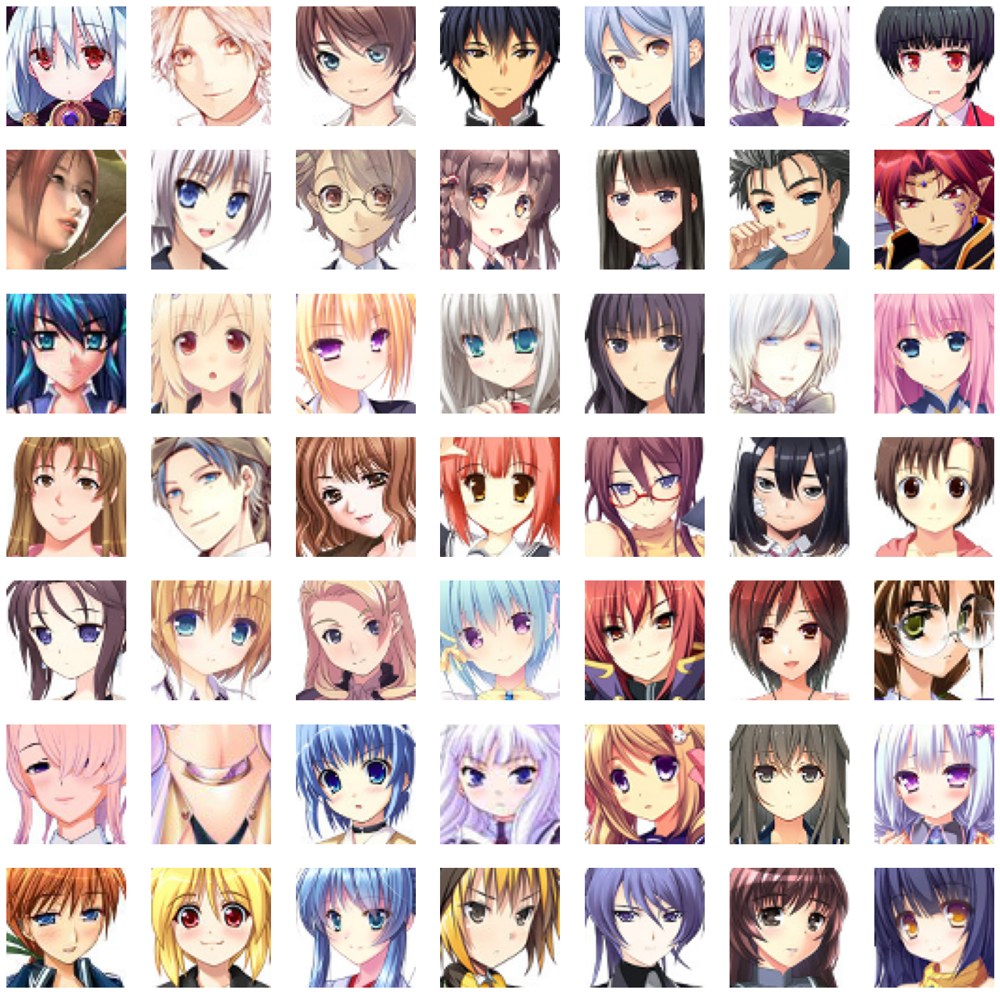

In [ ]:
# to display grid of images(7x7)
plt.figure(figsize = (20,20))
temp_images=image_paths[:49]
index=1

for image_path in temp_images:
    plt.subplot(7,7,index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # Incerment the index for next image
    index += 1

## Preprocess Images

In [ ]:
# Load the images and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [ ]:
train_images.shape

(21551, 64, 64, 3)

In [ ]:
train_images[:1].shape

(1, 64, 64, 3)

In [ ]:
train_images[:1].dtype

dtype('uint8')

In [ ]:
# Reshape and change to float32
train_images = train_images.reshape(train_images.shape[0],64,64,3).astype('float32')

In [ ]:
train_images[:1].shape

(1, 64, 64, 3)

In [ ]:
# Normalize the images
train_images = (train_images - 127.5) / 127.5

In [ ]:
train_images[0]

array([[[-0.7254902 , -0.90588236, -0.7176471 ],
        [-0.70980394, -0.88235295, -0.6862745 ],
        [-0.7019608 , -1.        , -0.7176471 ],
        ...,
        [-0.09019608,  0.01176471,  0.3882353 ],
        [-0.19215687,  0.05882353,  0.4509804 ],
        [-0.34117648, -0.13725491,  0.29411766]],

       [[-0.7254902 , -0.90588236, -0.7176471 ],
        [-0.73333335, -0.8666667 , -0.7019608 ],
        [-0.52156866, -0.8666667 , -0.5686275 ],
        ...,
        [-0.29411766,  0.01176471,  0.3019608 ],
        [-0.08235294,  0.15294118,  0.5294118 ],
        [-0.23921569,  0.09019608,  0.45882353]],

       [[-0.7019608 , -0.8901961 , -0.7019608 ],
        [-0.7176471 , -0.8745098 , -0.69411767],
        [-0.5686275 , -0.8509804 , -0.58431375],
        ...,
        [-0.22352941,  0.1764706 ,  0.48235294],
        [-0.13725491,  0.1764706 ,  0.4745098 ],
        [-0.06666667,  0.24705882,  0.5058824 ]],

       ...,

       [[-0.30980393, -0.6862745 , -0.29411766],
        [-0

## Create Generator and Discriminator

In [ ]:
# Latent dimension for random noise
LATENT_DIM = 100
# Weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0,stddev=0.02)
# mo.of channels of the image
CHANNELS = 3 # for graysclae keep it 1

## Generator model

In [ ]:
model = Sequential(name='generator')

#1d random noise
model.add(layers.Dense(8*8*512, input_dim=LATENT_DIM))
model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8,8,512)))
#upsample to 16x16
model.add(layers.Conv2DTranspose(256,(4,4),strides=(2,2),padding='same',kernel_initializer=WEIGHT_INIT))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())
#upsample to 32x32
model.add(layers.Conv2DTranspose(128,(4,4),strides=(2,2),padding='same',kernel_initializer=WEIGHT_INIT))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())
#upsample to 64x64
model.add(layers.Conv2DTranspose(64,(4,4),strides=(2,2),padding='same',kernel_initializer=WEIGHT_INIT))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# Final layer
model.add(layers.Conv2D(CHANNELS,(4,4),padding='same',activation='tanh'))

generator = model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 32768)          │     3,309,568 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 32768)          │       131,072 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu (ReLU)                    │ (None, 32768)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 16, 16, 256)    │     2,097,408 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_1 (ReLU)                  │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 32, 32, 128)    │       524,416 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_2 (ReLU)                  │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 64, 64, 64)     │       131,136 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_3 (ReLU)                  │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 3)      │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,196,675 (23.64 MB)

 Trainable params: 6,131,139 (23.39 MB)

 Non-trainable params: 65,536 (256.00 KB)

## Disvriminator model

In [ ]:
model = Sequential(name = 'discriminator')
input_shape = (64,64,3)
alpha=0.2

# Create conv layers
model.add(layers.Conv2D(64,(4,4),strides=(2,2),padding='same',input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

# Create conv layers
model.add(layers.Conv2D(128,(4,4),strides=(2,2),padding='same',input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))
# Create conv layers
model.add(layers.Conv2D(128,(4,4),strides=(2,2),padding='same',input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# Output class
model.add(layers.Dense(1,activation='sigmoid'))

discriminator = model

discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_1 (Conv2D)               │ (None, 32, 32, 64)     │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 32, 32, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 16, 16, 128)    │       131,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 8, 8, 128)      │       262,272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 8, 8, 128)      │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │         8,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

## Training Process

In [ ]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)

            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2

        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))


        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)

        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [ ]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [ ]:
dcgan = DCGAN(generator,discriminator,latent_dim=LATENT_DIM)

In [ ]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR,beta_1=0.5),d_optimizer=Adam(learning_rate=D_LR,beta_1=0.5),loss_fn = BinaryCrossentropy())

Epoch 1/50
  1/674 ━━━━━━━━━━━━━━━━━━━━ 4:37:52 25s/step - d_loss: 0.8712 - g_loss: 0.9881

I0000 00:00:1713060821.047469      77 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - d_loss: 1.0723 - g_loss: 1.9807

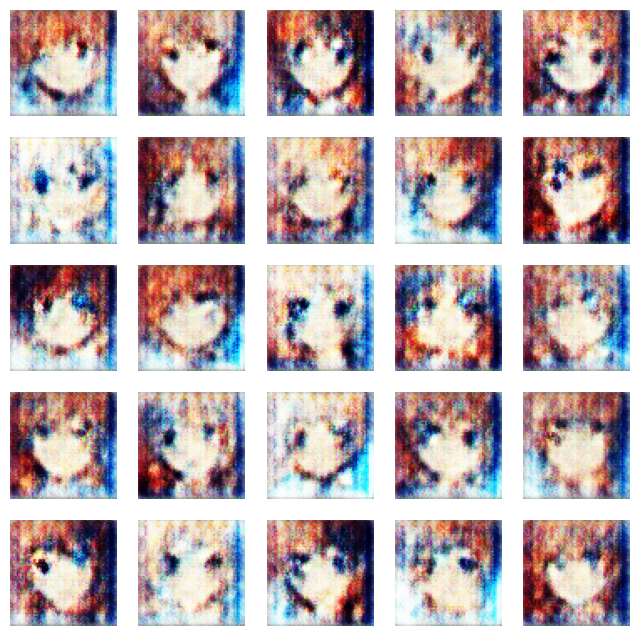

674/674 ━━━━━━━━━━━━━━━━━━━━ 84s 88ms/step - d_loss: 1.0718 - g_loss: 1.9808
Epoch 2/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.7913 - g_loss: 0.8699

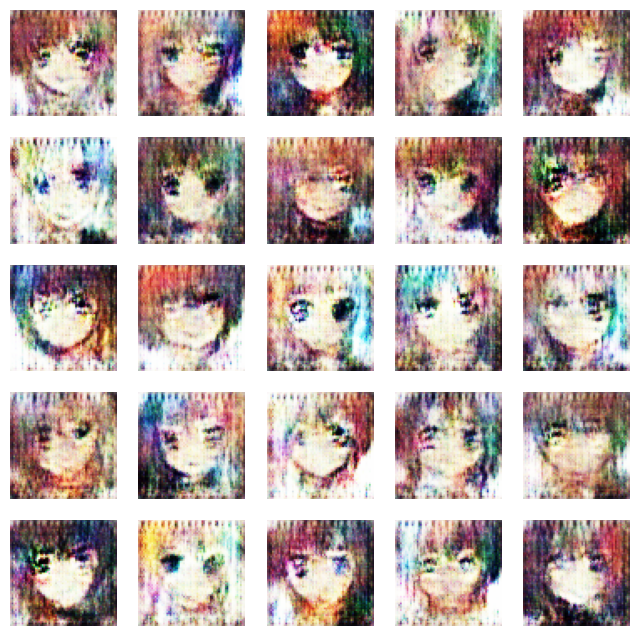

674/674 ━━━━━━━━━━━━━━━━━━━━ 48s 64ms/step - d_loss: 0.7912 - g_loss: 0.8699
Epoch 3/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7402 - g_loss: 0.8057

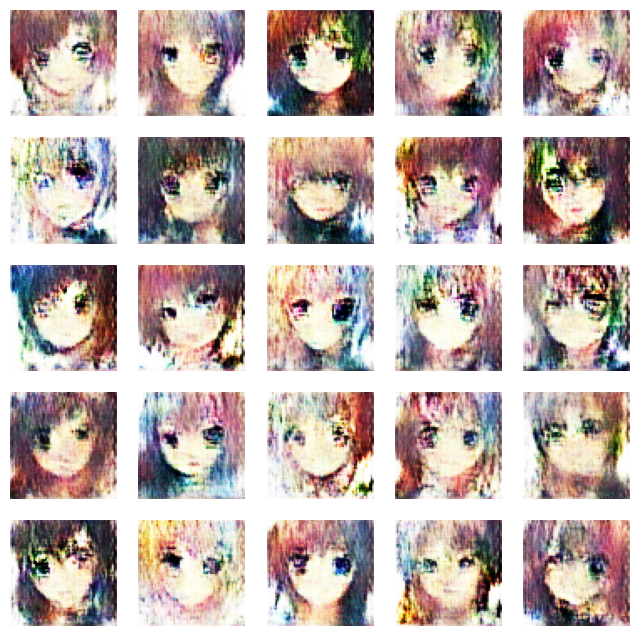

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 63ms/step - d_loss: 0.7402 - g_loss: 0.8056
Epoch 4/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7284 - g_loss: 0.7705

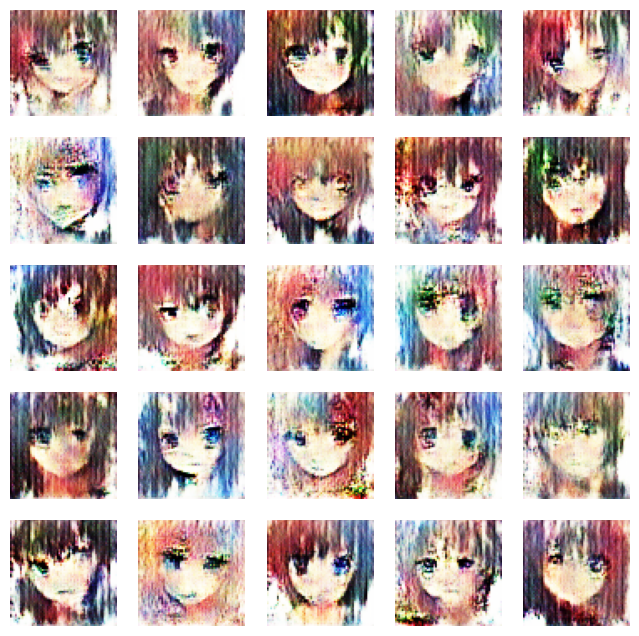

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 63ms/step - d_loss: 0.7284 - g_loss: 0.7705
Epoch 5/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.7258 - g_loss: 0.7746

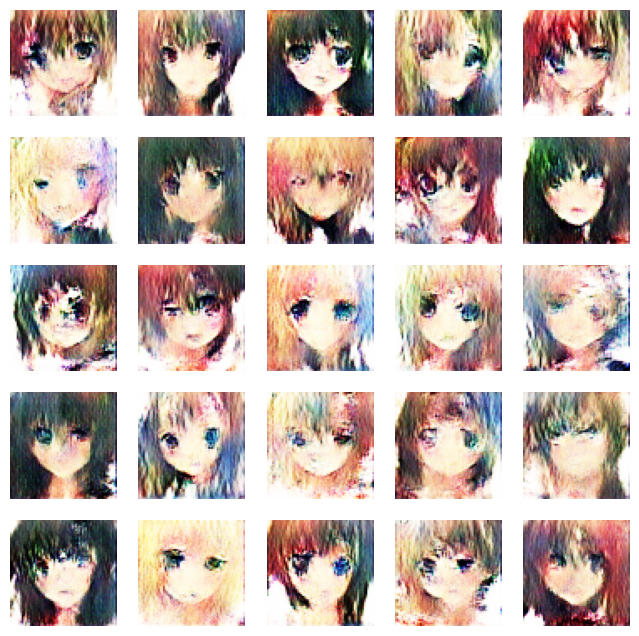

674/674 ━━━━━━━━━━━━━━━━━━━━ 83s 64ms/step - d_loss: 0.7258 - g_loss: 0.7746
Epoch 6/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7385 - g_loss: 0.7097

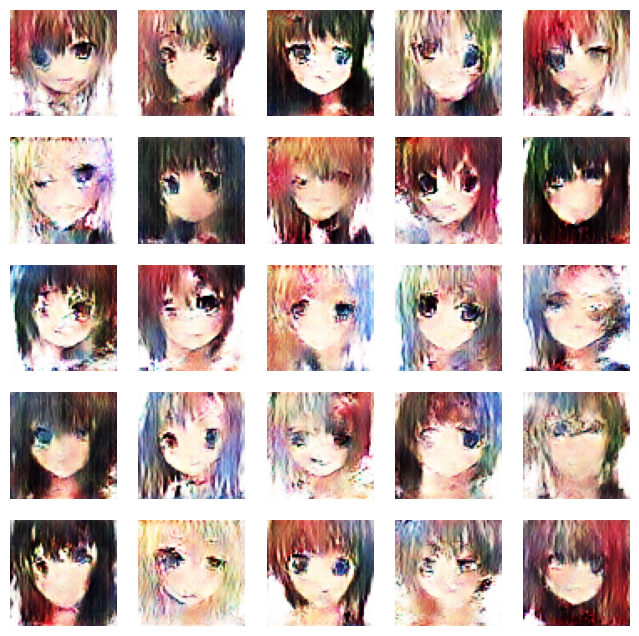

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 63ms/step - d_loss: 0.7385 - g_loss: 0.7097
Epoch 7/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7288 - g_loss: 0.7013

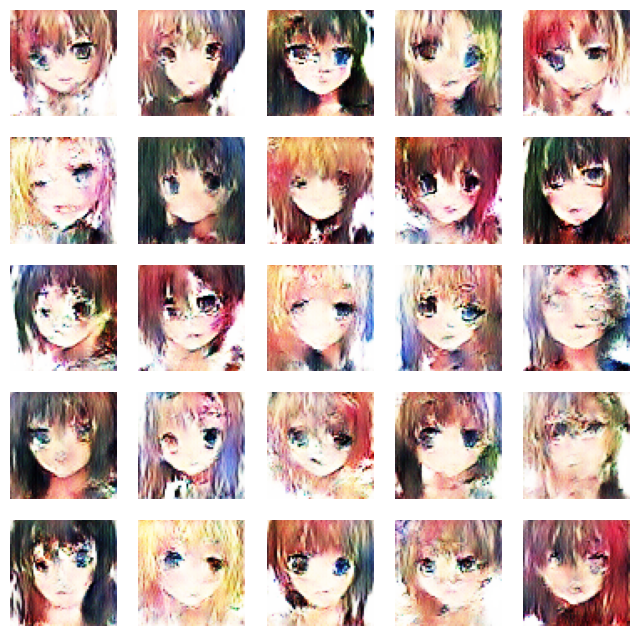

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 63ms/step - d_loss: 0.7288 - g_loss: 0.7013
Epoch 8/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7238 - g_loss: 0.6935

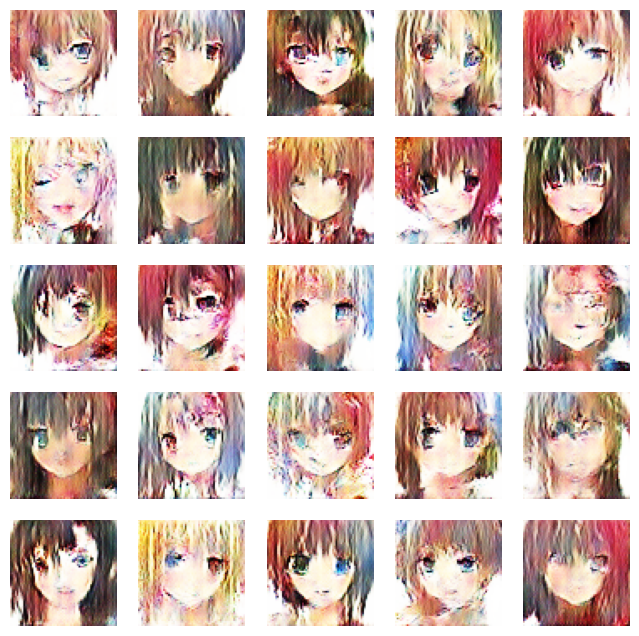

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.7237 - g_loss: 0.6935
Epoch 9/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7221 - g_loss: 0.6898

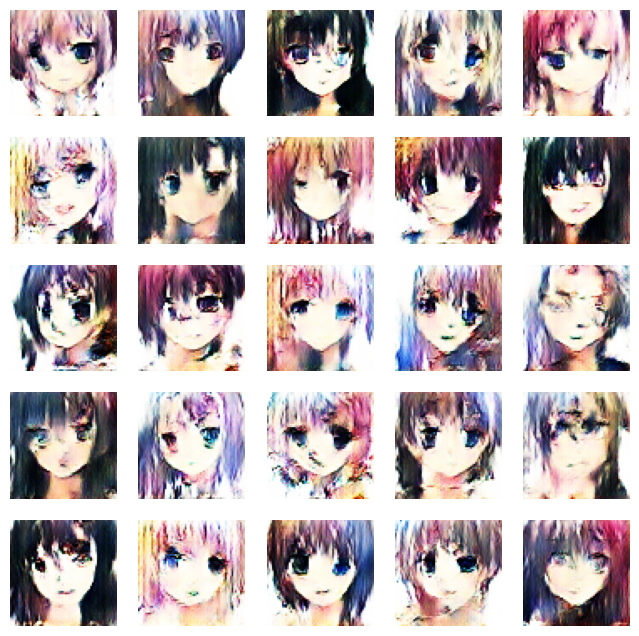

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 63ms/step - d_loss: 0.7221 - g_loss: 0.6898
Epoch 10/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7162 - g_loss: 0.6928

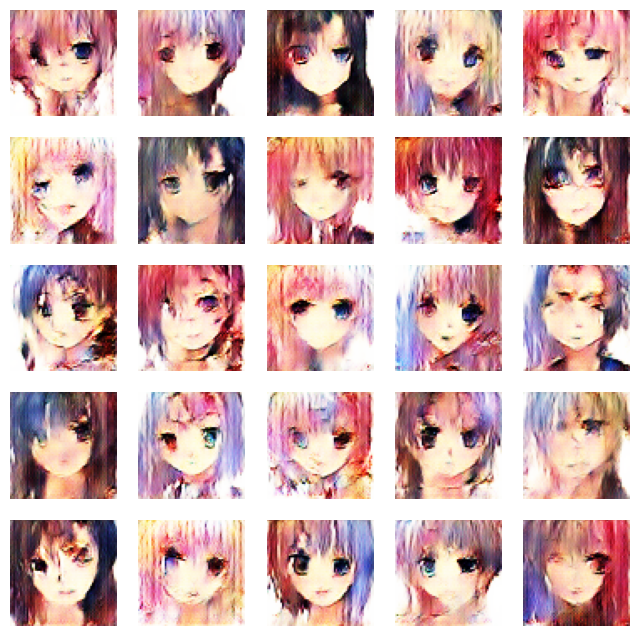

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 63ms/step - d_loss: 0.7162 - g_loss: 0.6928
Epoch 11/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7127 - g_loss: 0.6905

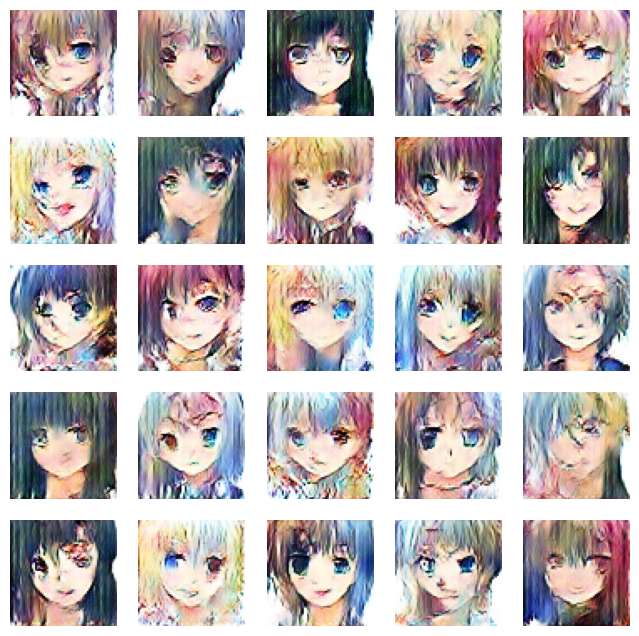

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.7127 - g_loss: 0.6905
Epoch 12/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7078 - g_loss: 0.7008

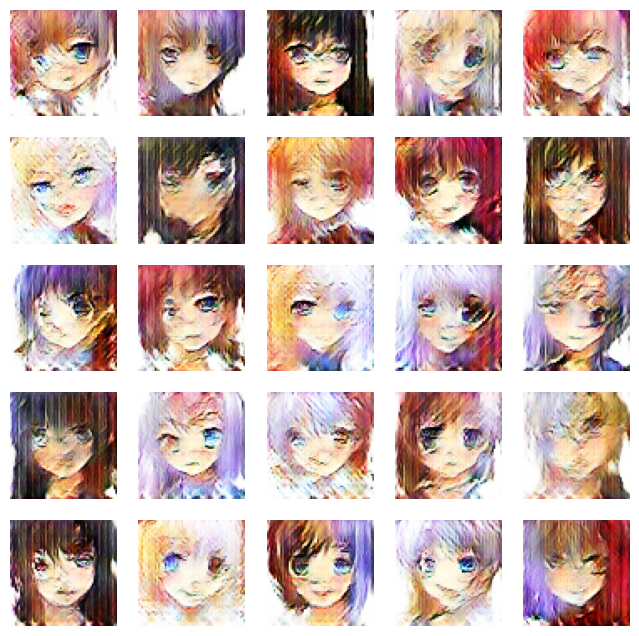

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 63ms/step - d_loss: 0.7078 - g_loss: 0.7008
Epoch 13/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7118 - g_loss: 0.7053

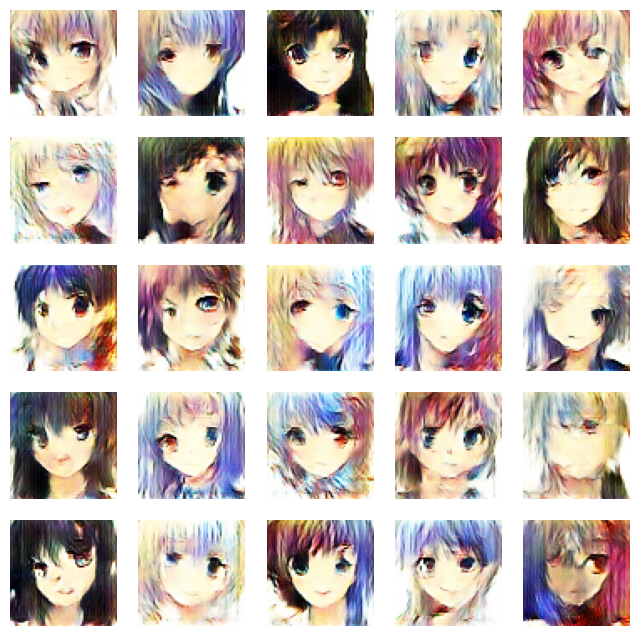

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 63ms/step - d_loss: 0.7118 - g_loss: 0.7053
Epoch 14/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7079 - g_loss: 0.6917

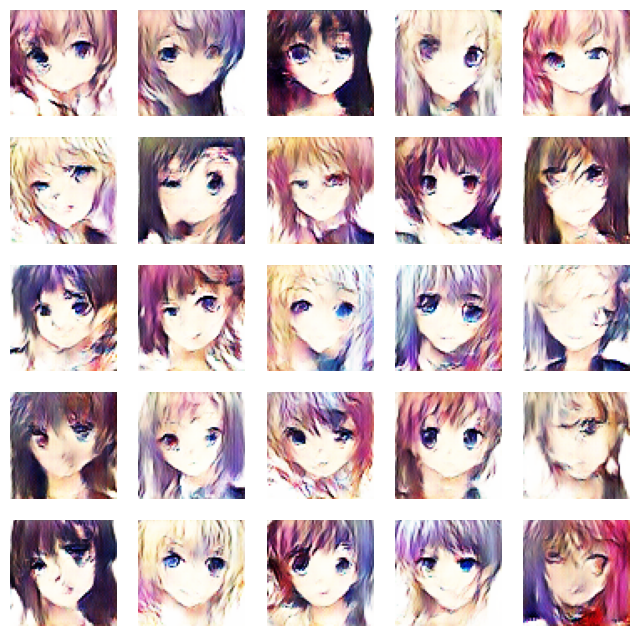

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.7079 - g_loss: 0.6917
Epoch 15/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7087 - g_loss: 0.6905

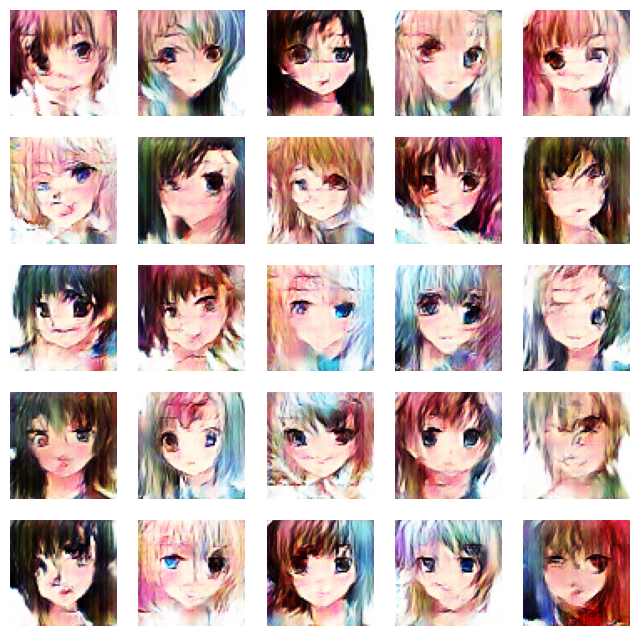

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 63ms/step - d_loss: 0.7087 - g_loss: 0.6905
Epoch 16/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7080 - g_loss: 0.6925

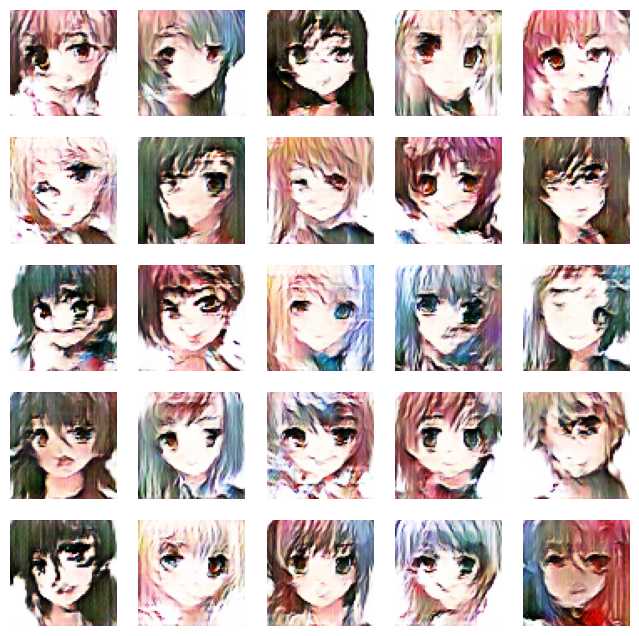

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.7080 - g_loss: 0.6925
Epoch 17/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7089 - g_loss: 0.6888

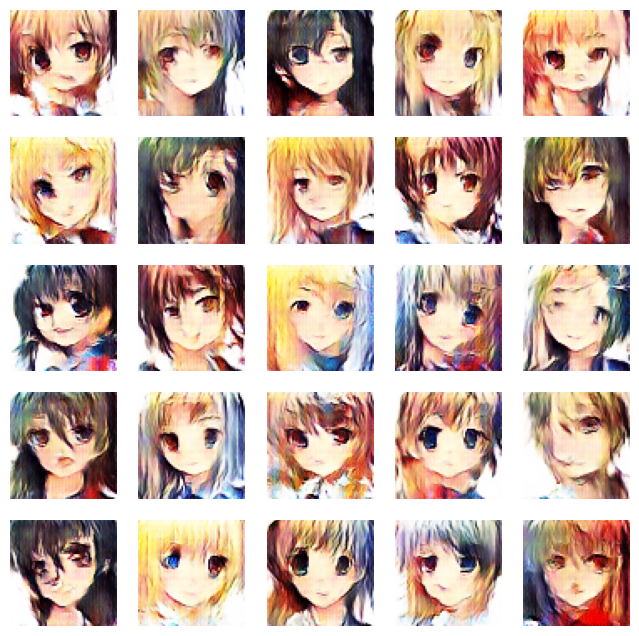

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.7089 - g_loss: 0.6888
Epoch 18/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7068 - g_loss: 0.6904

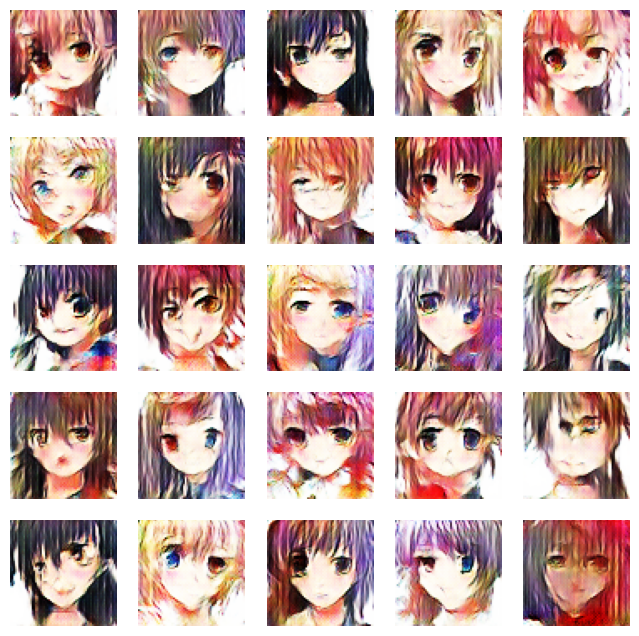

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 63ms/step - d_loss: 0.7068 - g_loss: 0.6904
Epoch 19/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7064 - g_loss: 0.6904

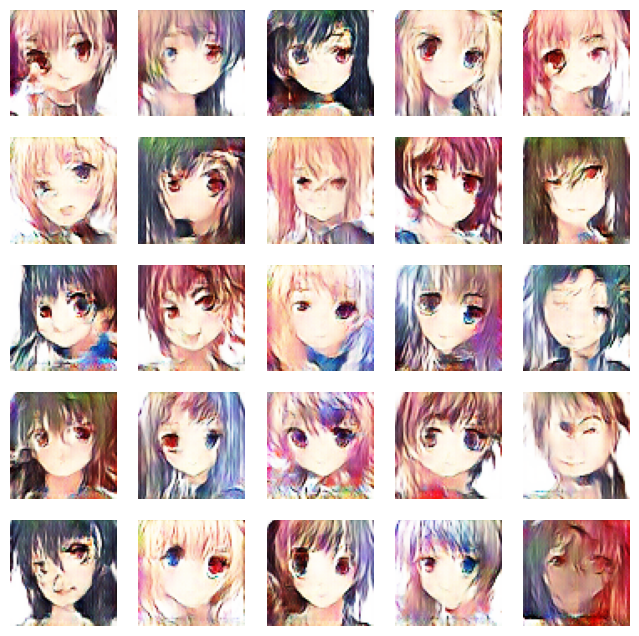

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.7064 - g_loss: 0.6904
Epoch 20/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7062 - g_loss: 0.6914

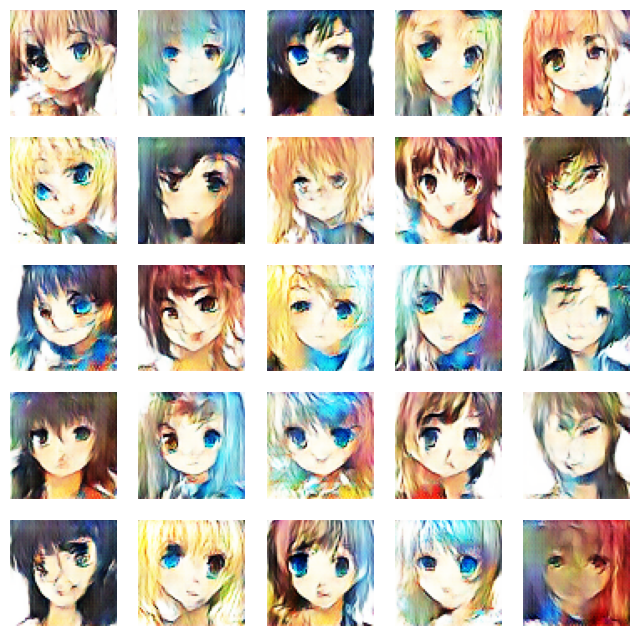

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 63ms/step - d_loss: 0.7062 - g_loss: 0.6914
Epoch 21/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7055 - g_loss: 0.6905

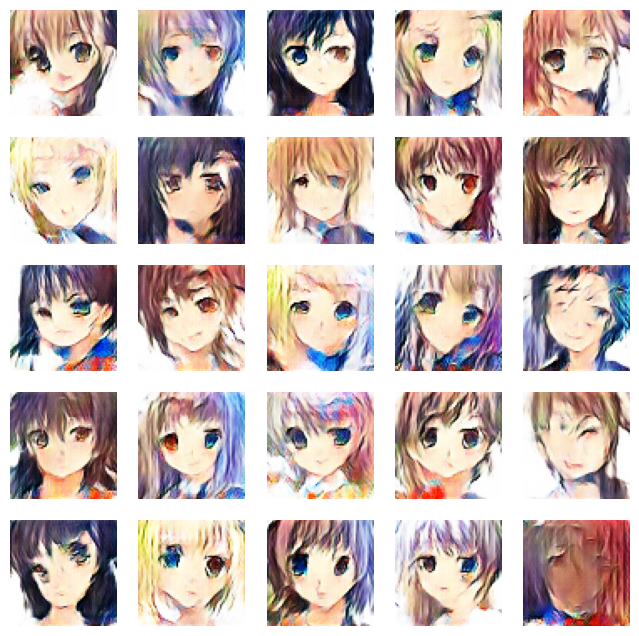

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 63ms/step - d_loss: 0.7055 - g_loss: 0.6905
Epoch 22/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7038 - g_loss: 0.6910

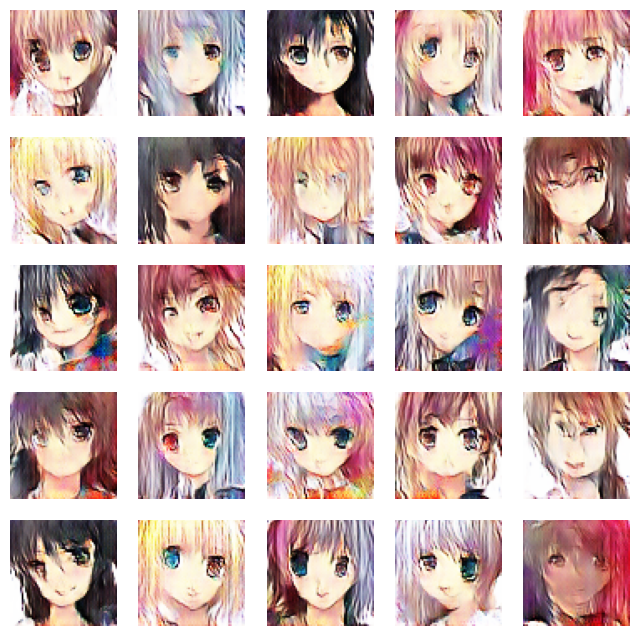

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.7038 - g_loss: 0.6910
Epoch 23/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7040 - g_loss: 0.6910

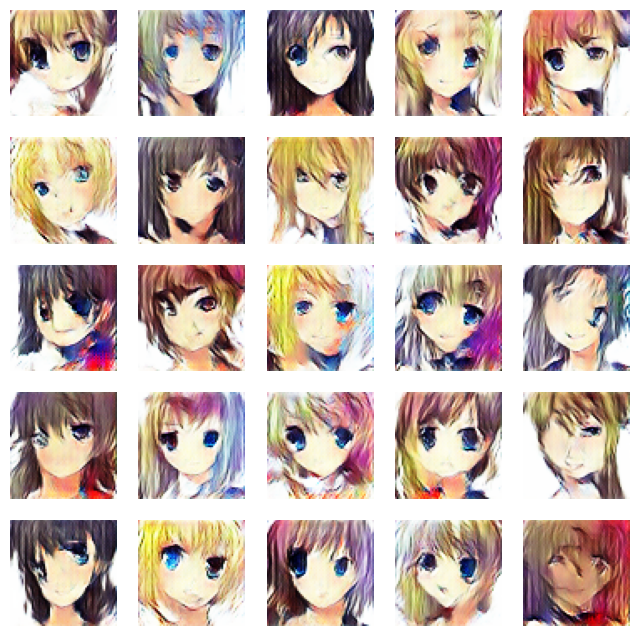

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 63ms/step - d_loss: 0.7040 - g_loss: 0.6910
Epoch 24/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7023 - g_loss: 0.6927

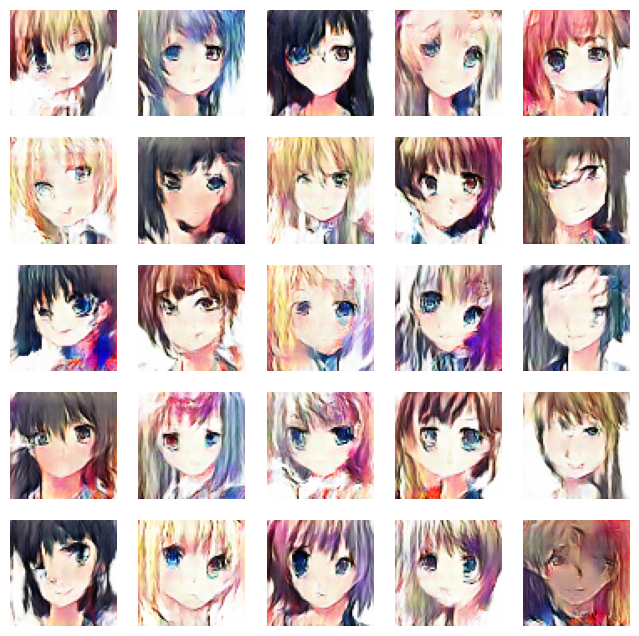

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.7023 - g_loss: 0.6927
Epoch 25/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7039 - g_loss: 0.6909

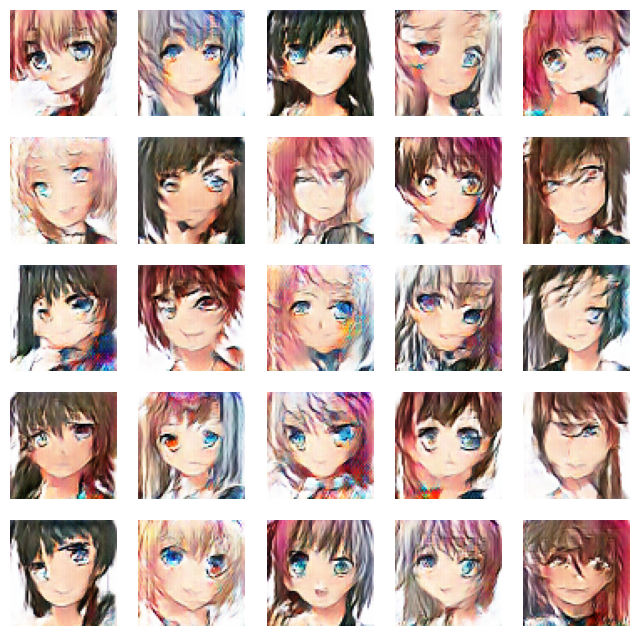

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.7039 - g_loss: 0.6909
Epoch 26/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7021 - g_loss: 0.6947

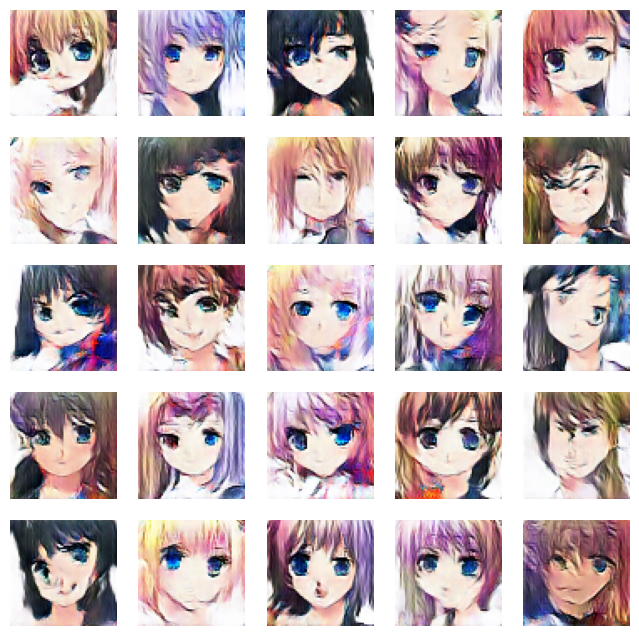

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 63ms/step - d_loss: 0.7021 - g_loss: 0.6947
Epoch 27/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7025 - g_loss: 0.6896

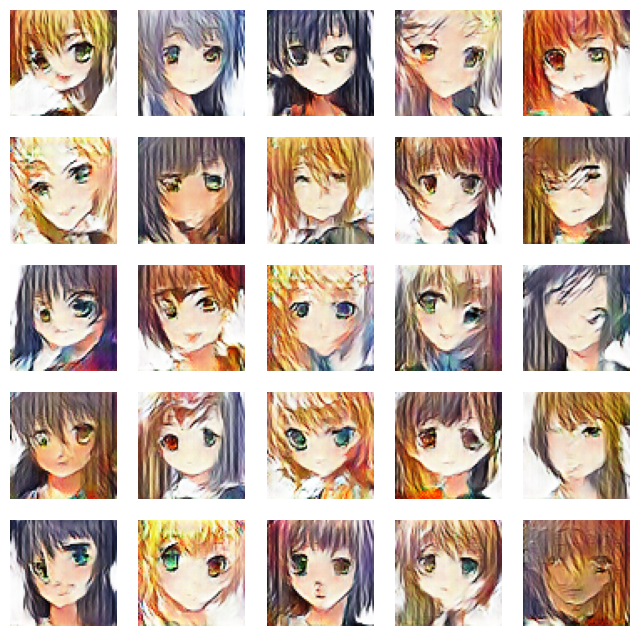

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.7025 - g_loss: 0.6896
Epoch 28/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7015 - g_loss: 0.6929

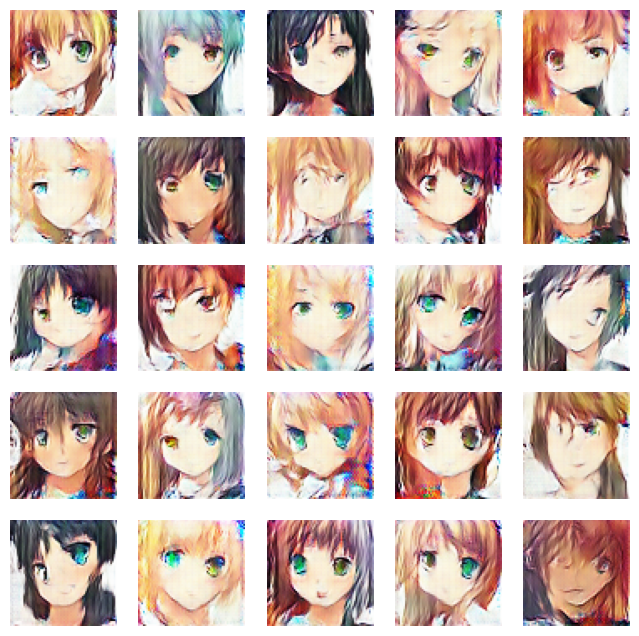

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.7015 - g_loss: 0.6929
Epoch 29/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7013 - g_loss: 0.6893

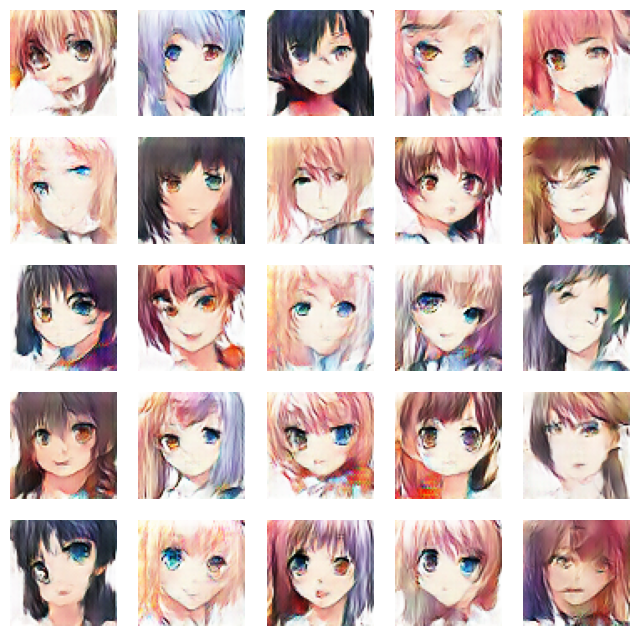

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 63ms/step - d_loss: 0.7013 - g_loss: 0.6893
Epoch 30/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7006 - g_loss: 0.6879

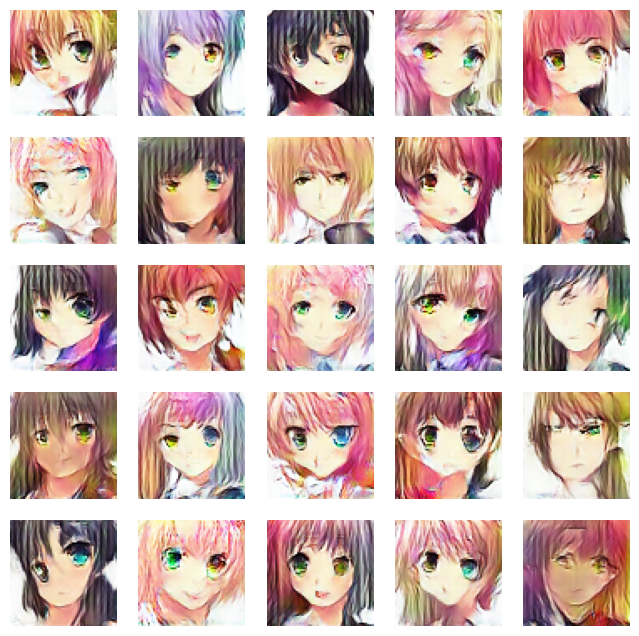

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.7006 - g_loss: 0.6879
Epoch 31/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7003 - g_loss: 0.6911

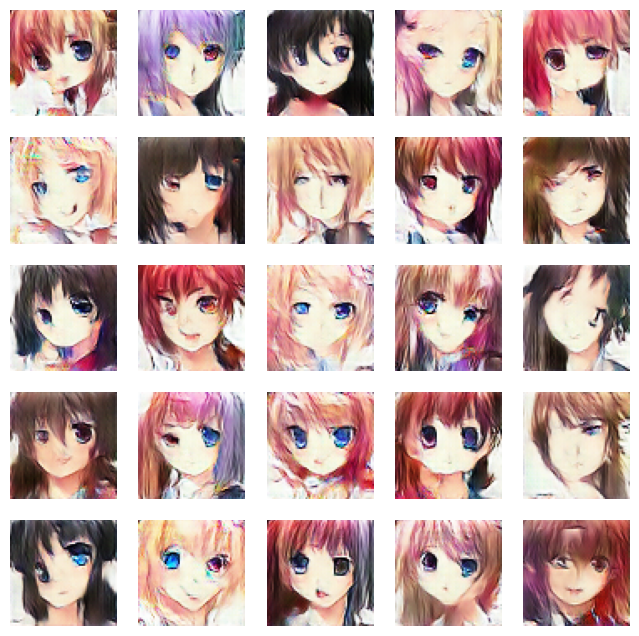

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.7003 - g_loss: 0.6911
Epoch 32/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6990 - g_loss: 0.6920

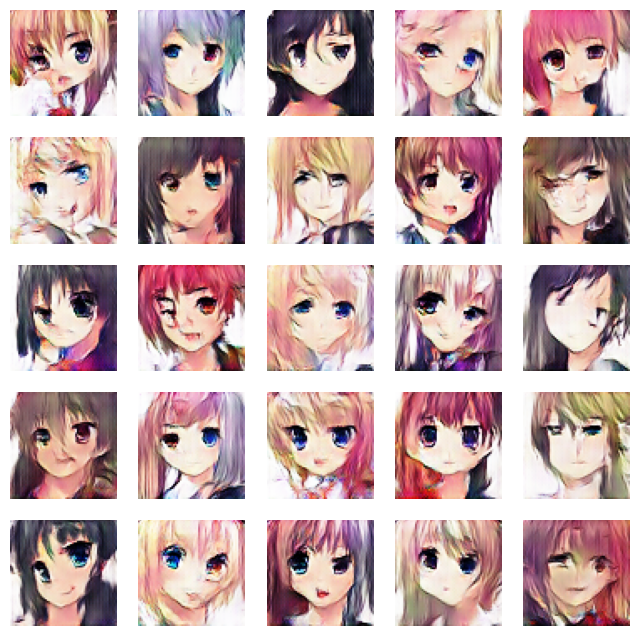

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 63ms/step - d_loss: 0.6990 - g_loss: 0.6920
Epoch 33/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6987 - g_loss: 0.6931

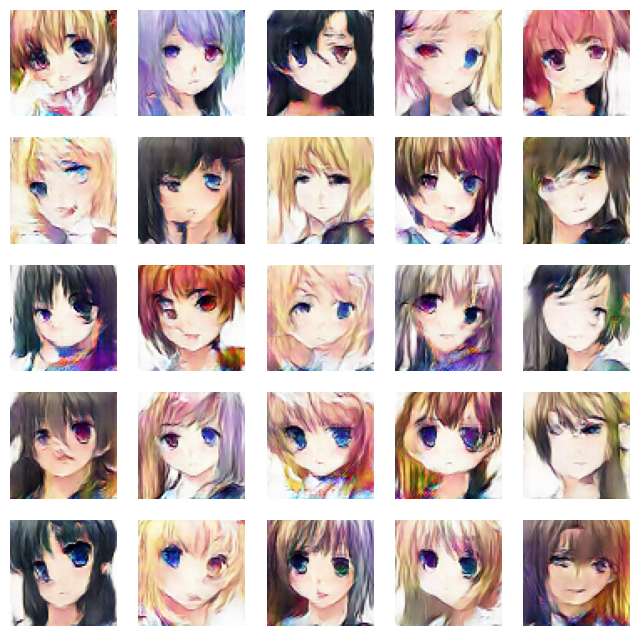

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6987 - g_loss: 0.6931
Epoch 34/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6976 - g_loss: 0.6957

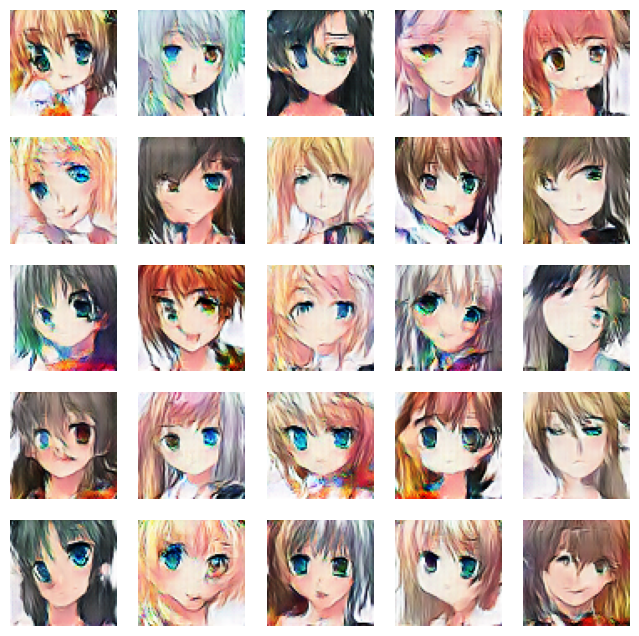

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6976 - g_loss: 0.6957
Epoch 35/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6966 - g_loss: 0.6976

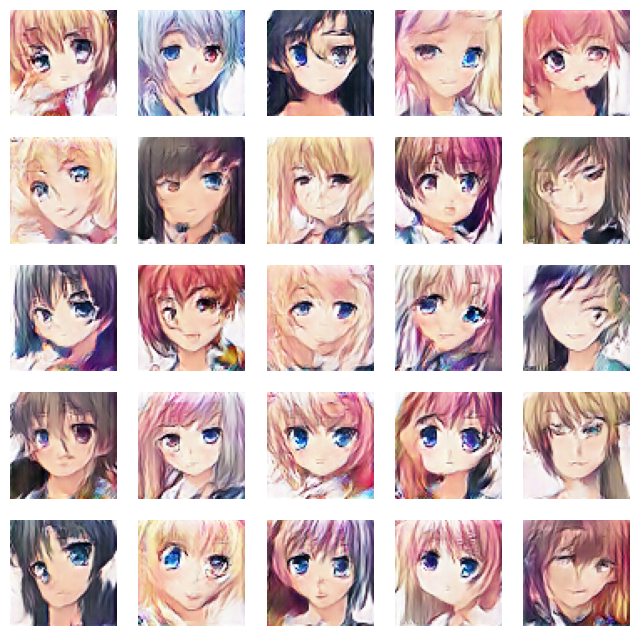

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 63ms/step - d_loss: 0.6966 - g_loss: 0.6976
Epoch 36/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6954 - g_loss: 0.6976

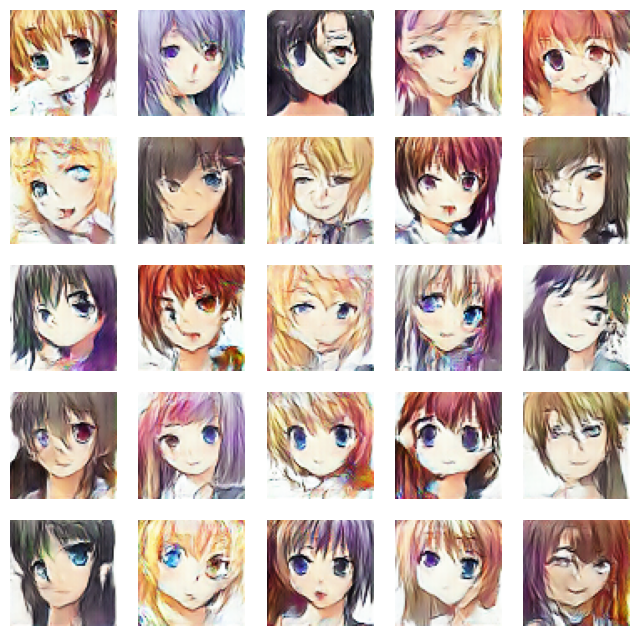

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 63ms/step - d_loss: 0.6954 - g_loss: 0.6976
Epoch 37/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6946 - g_loss: 0.7021

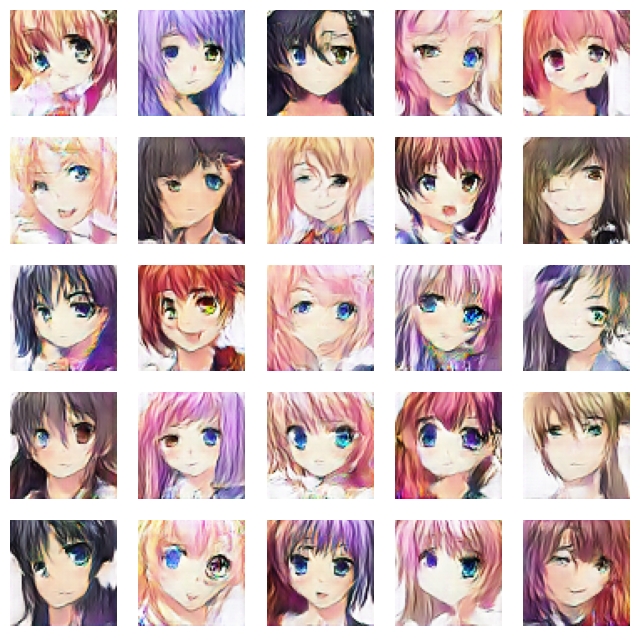

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6946 - g_loss: 0.7021
Epoch 38/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6954 - g_loss: 0.7043

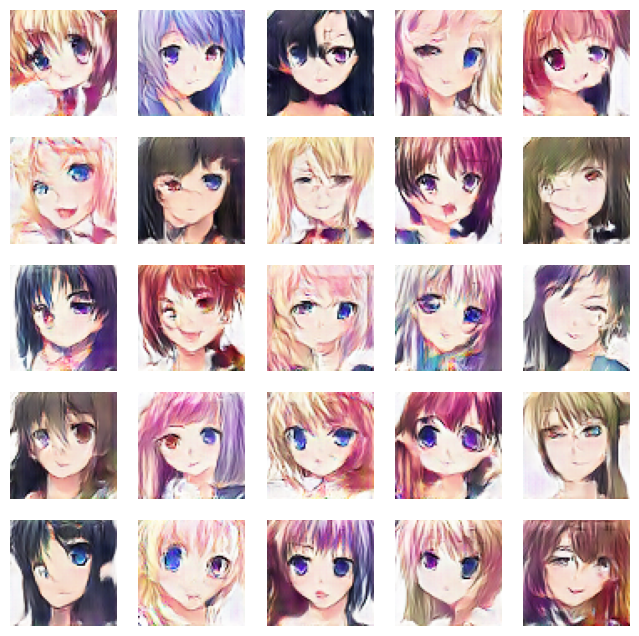

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 63ms/step - d_loss: 0.6954 - g_loss: 0.7043
Epoch 39/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6929 - g_loss: 0.7082

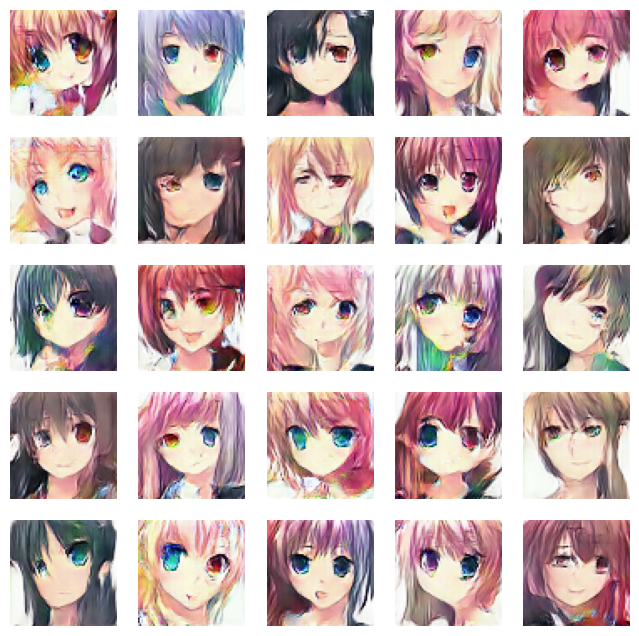

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6929 - g_loss: 0.7082
Epoch 40/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6912 - g_loss: 0.7150

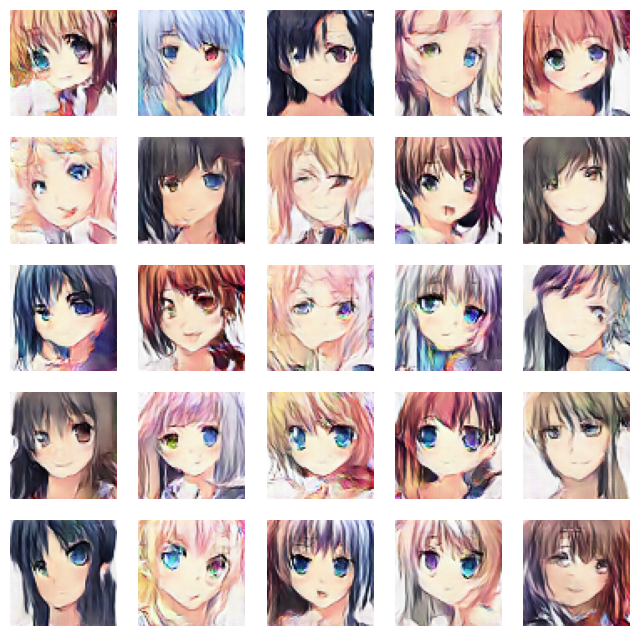

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6912 - g_loss: 0.7150
Epoch 41/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6900 - g_loss: 0.7164

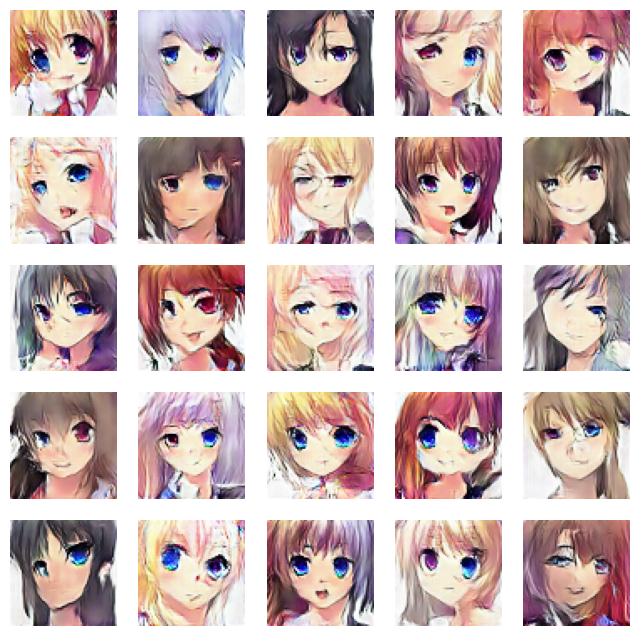

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 63ms/step - d_loss: 0.6900 - g_loss: 0.7164
Epoch 42/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6896 - g_loss: 0.7216

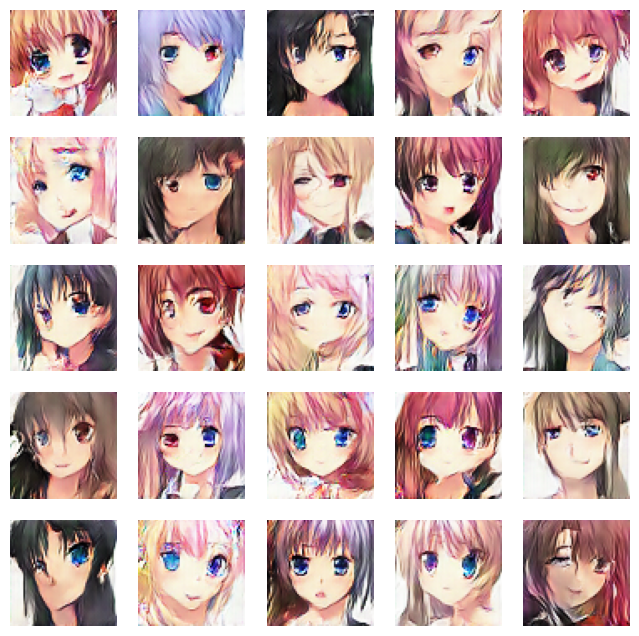

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6896 - g_loss: 0.7216
Epoch 43/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6851 - g_loss: 0.7254

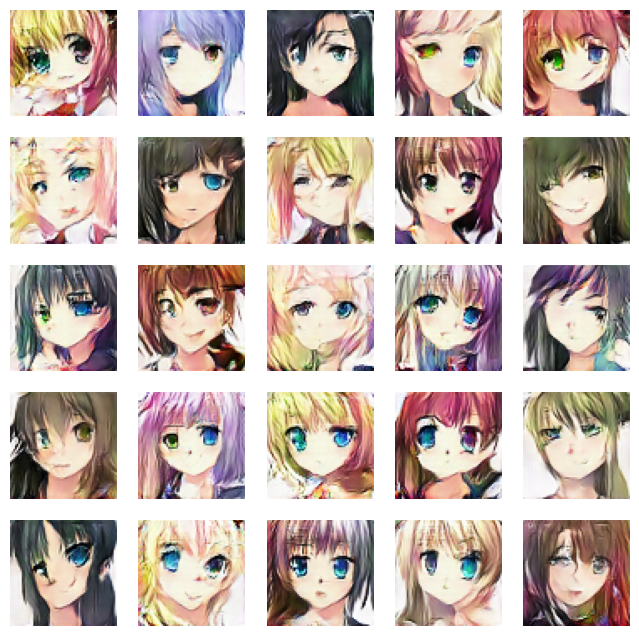

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6851 - g_loss: 0.7254
Epoch 44/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6859 - g_loss: 0.7260

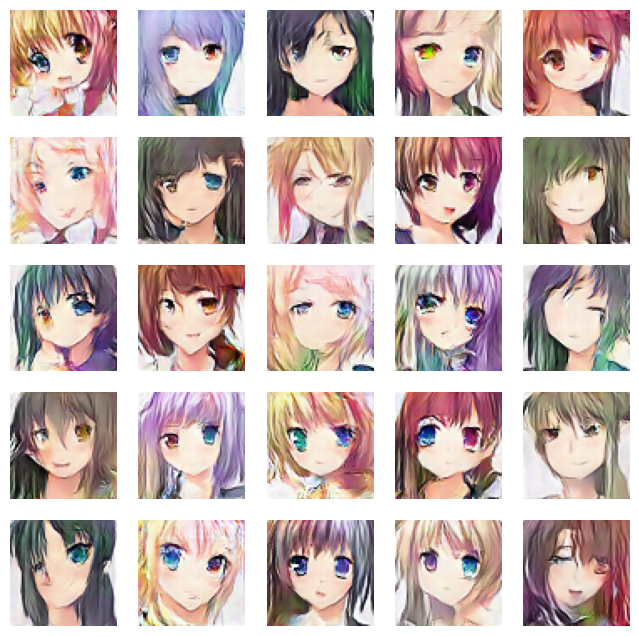

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 63ms/step - d_loss: 0.6859 - g_loss: 0.7260
Epoch 45/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6824 - g_loss: 0.7376

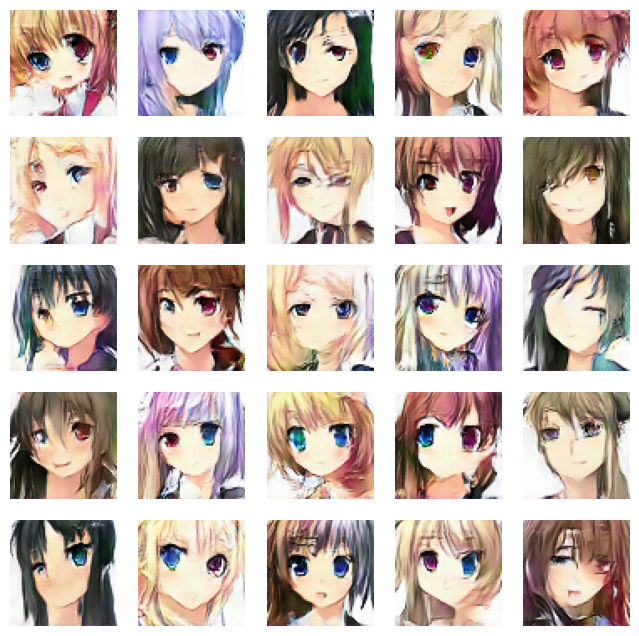

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6824 - g_loss: 0.7376
Epoch 46/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6804 - g_loss: 0.7470

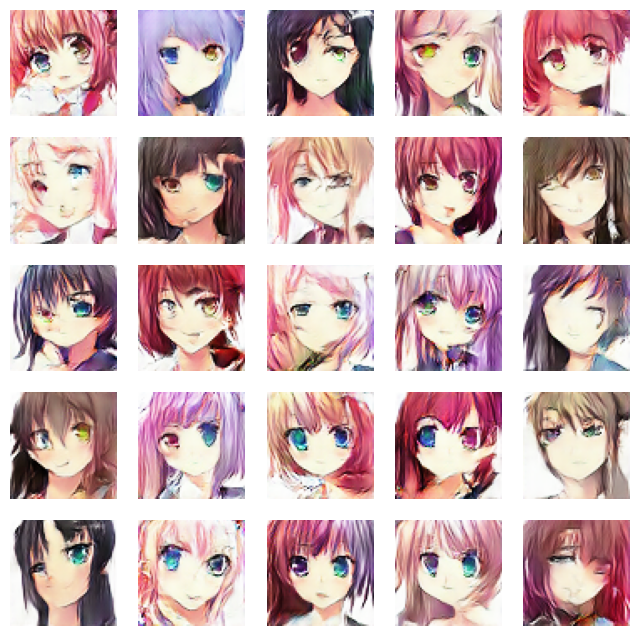

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6804 - g_loss: 0.7470
Epoch 47/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6781 - g_loss: 0.7540

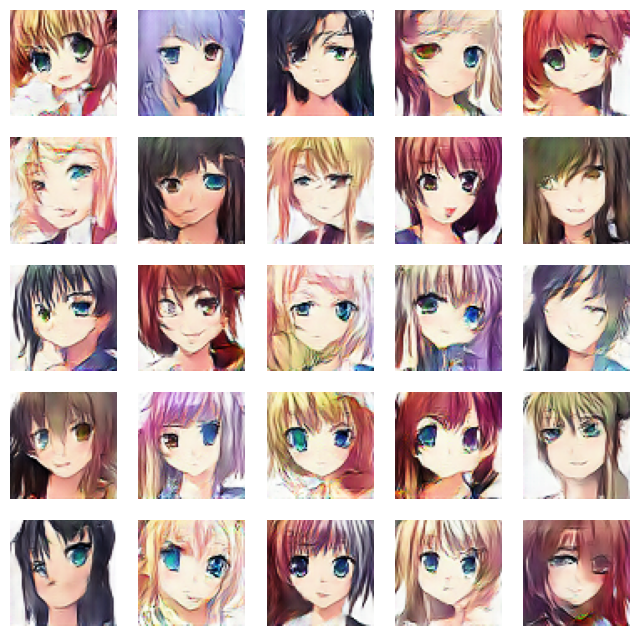

674/674 ━━━━━━━━━━━━━━━━━━━━ 43s 63ms/step - d_loss: 0.6781 - g_loss: 0.7540
Epoch 48/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6733 - g_loss: 0.7636

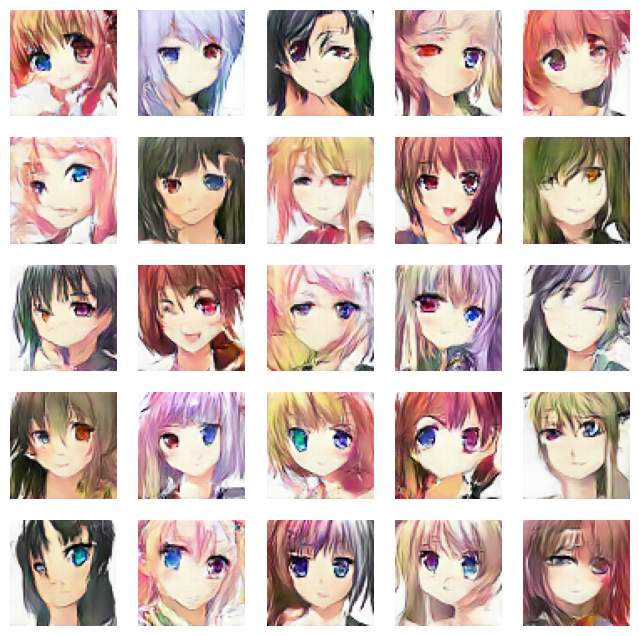

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6733 - g_loss: 0.7636
Epoch 49/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6708 - g_loss: 0.7712

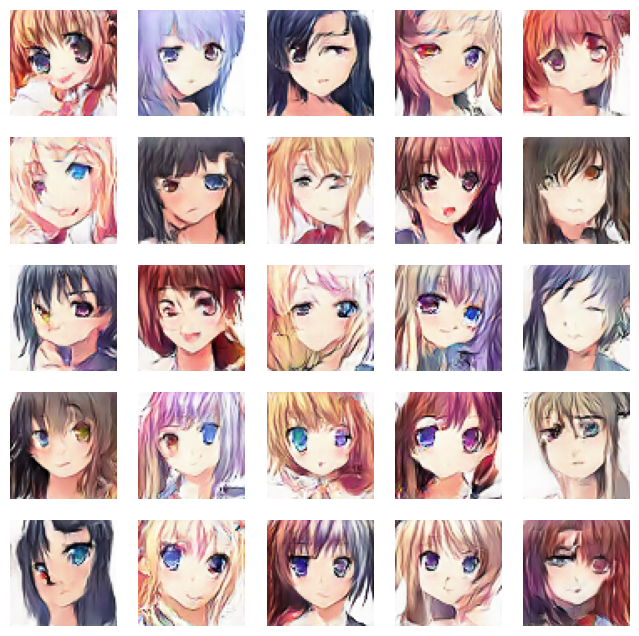

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6708 - g_loss: 0.7712
Epoch 50/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6683 - g_loss: 0.7813

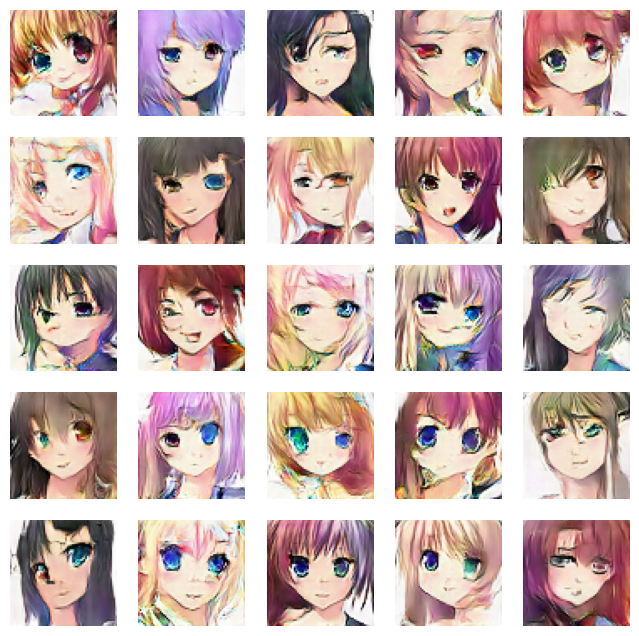

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6683 - g_loss: 0.7813


In [ ]:
dcgan.fit(train_images , epochs = 50, callbacks = [DCGANMonitor()])

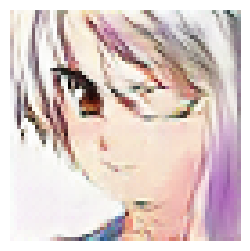

In [ ]:
noise = tf.random.normal([1,100])
fig = plt.figure(figsize=(3,3))
# generate the image from thr noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
plt.show()